
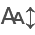

In [1]:
# Imports
import pandas as pd
import seaborn as sns

from IPython.display import display

import itables
from itables import init_notebook_mode

# Specific imports from ccf_medication modules
from ccf_medication.utils.loading import (
    load_and_format_all_results, 
    format_samples_with_disease_severity,
)

from ccf_medication.plotting.stripplots import plot_strip_box_plot
from ccf_medication.plotting.utils import build_fixed_palette

# Constants
from ccf_medication.constants.pathing import (
    ACTIVE_TX_DATAFRAME_PATH,
    REMISSION_TX_DATAFRAME_PATH,
    ACTIVE_PX_DATAFRAME_PATH,
    REMISSION_PX_DATAFRAME_PATH,
)

from ccf_medication.constants.tables import NO_MEDICATION

from ccf_medication.constants.plotting import (
    MUTED_MODERN_REM_VS_ACT,
    MUTED_MODERN_ALL_DRUGS,
    PLOTTING_DRUG_FAMILIES_MAP,
)


# Initialize notebook mode
init_notebook_mode(all_interactive=True)
itables.options.allow_html = True

# Pretty Dataframes
pd.options.mode.chained_assignment = None
sns.set(style="whitegrid")

# Load the Data Files

Loading the samples

In [2]:
# load the samples
tx_remission_samples = pd.read_parquet(REMISSION_TX_DATAFRAME_PATH)
px_remission_samples = pd.read_parquet(REMISSION_PX_DATAFRAME_PATH)
tx_active_samples = pd.read_parquet(ACTIVE_TX_DATAFRAME_PATH)
px_active_samples = pd.read_parquet(ACTIVE_PX_DATAFRAME_PATH)

tx_samples = pd.concat([tx_remission_samples, tx_active_samples])
px_samples = pd.concat([px_remission_samples, px_active_samples])

tx_samples_subset, px_samples_subset = format_samples_with_disease_severity(tx_samples=tx_samples, px_samples=px_samples)

Loading the results

In [3]:
(tx_response, px_response, tx_signif_rem_vs_act, px_signif_rem_vs_act, tx_signif_med_vs_no_med, px_signif_med_vs_no_med), (tx_rem_vs_act, px_rem_vs_act, tx_med_vs_no_med, px_med_vs_no_med) = load_and_format_all_results()

# Remission vs. Active Plots for Signif Genes (For Figure 3)

#### Utils

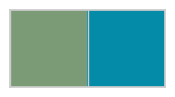

In [4]:
sns.palplot(MUTED_MODERN_REM_VS_ACT)
# color_palettes.append(muted_modern)

disease_severity_mapping = {"remission": 0, "severe": 1, "moderate": 1}

disease_severity_palette = {0:MUTED_MODERN_REM_VS_ACT[0], 1:MUTED_MODERN_REM_VS_ACT[1]}
disease_severity_labels = {0: "Remission", 1: "Active"}

Find the biomarkers to plot

In [5]:
relevant_biomarkers = ["DYSF", "CXCL2", "CXCL8", "S100A8", "IL12B", "CD6", "MXRA8", "CXCL9", "IFNG", "CCN3", "RSPO3", "IL18"]
plotting_tx_subset = tx_signif_rem_vs_act[tx_signif_rem_vs_act['feature'].isin(relevant_biomarkers)].sort_values(by='feature')
plotting_px_subset = px_signif_rem_vs_act[px_signif_rem_vs_act['feature'].str.split('_').str[0].isin(relevant_biomarkers)].sort_values(by='feature')
print(plotting_tx_subset.shape)
print(plotting_px_subset.shape)

(36, 12)
(20, 11)


#### Transcriptomics

/home/timothy.hart/ccf-medication/ccf_medication/plotting/stripplots.py:141: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=figsize, dpi=dpi)


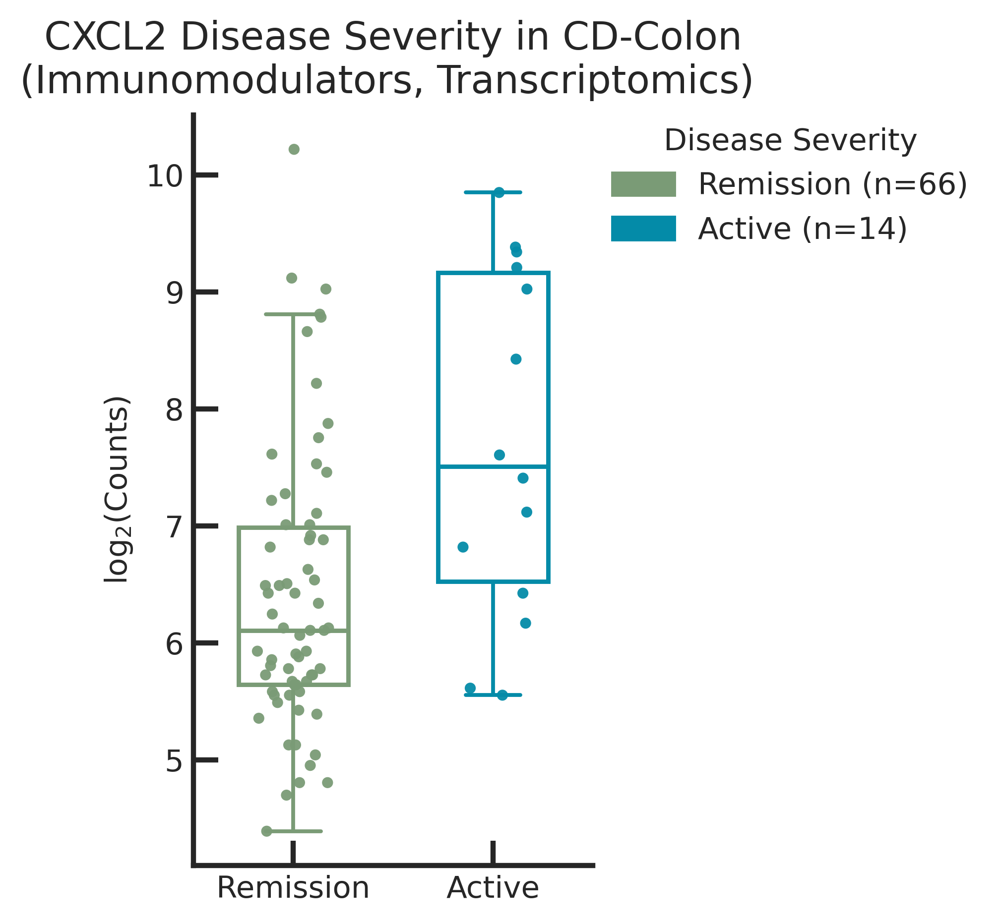

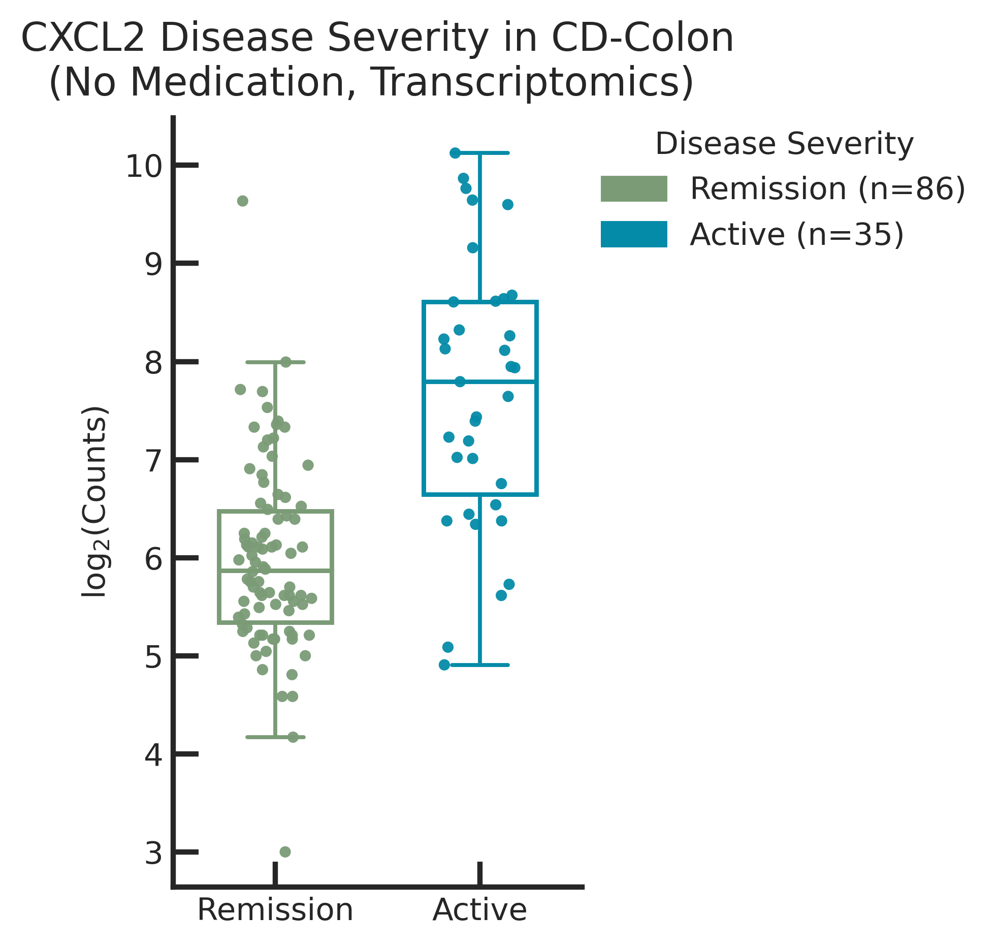

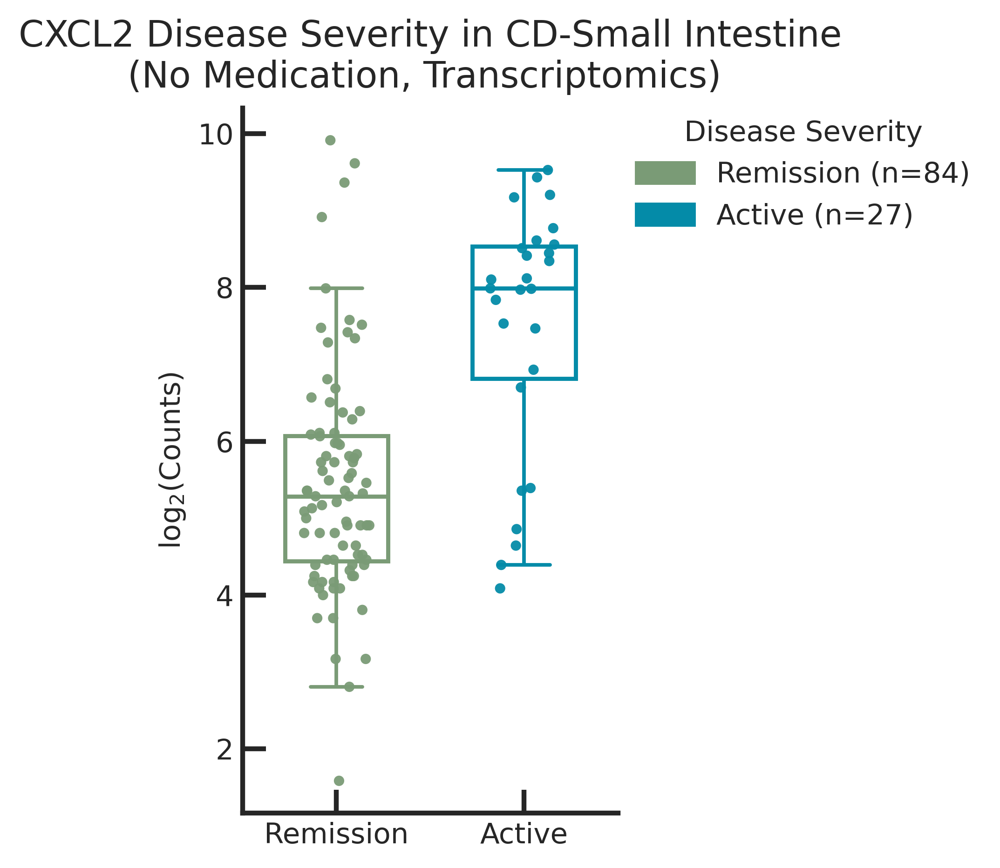

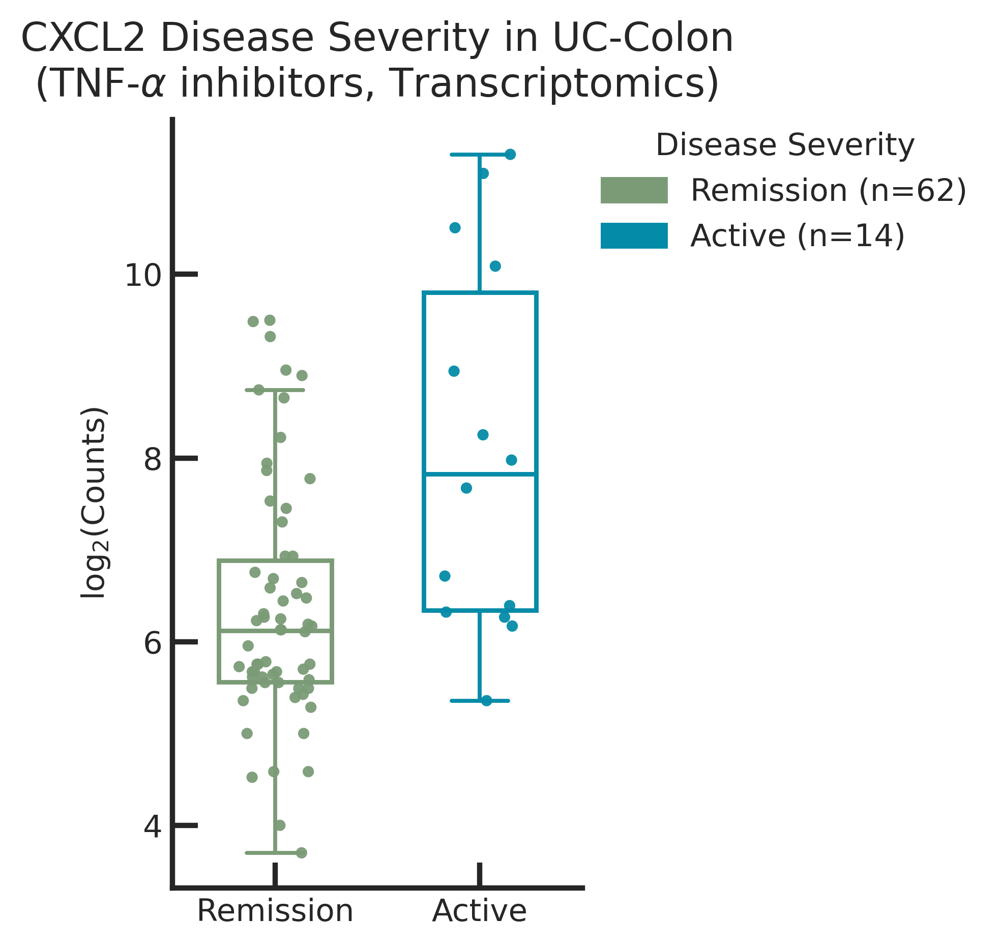

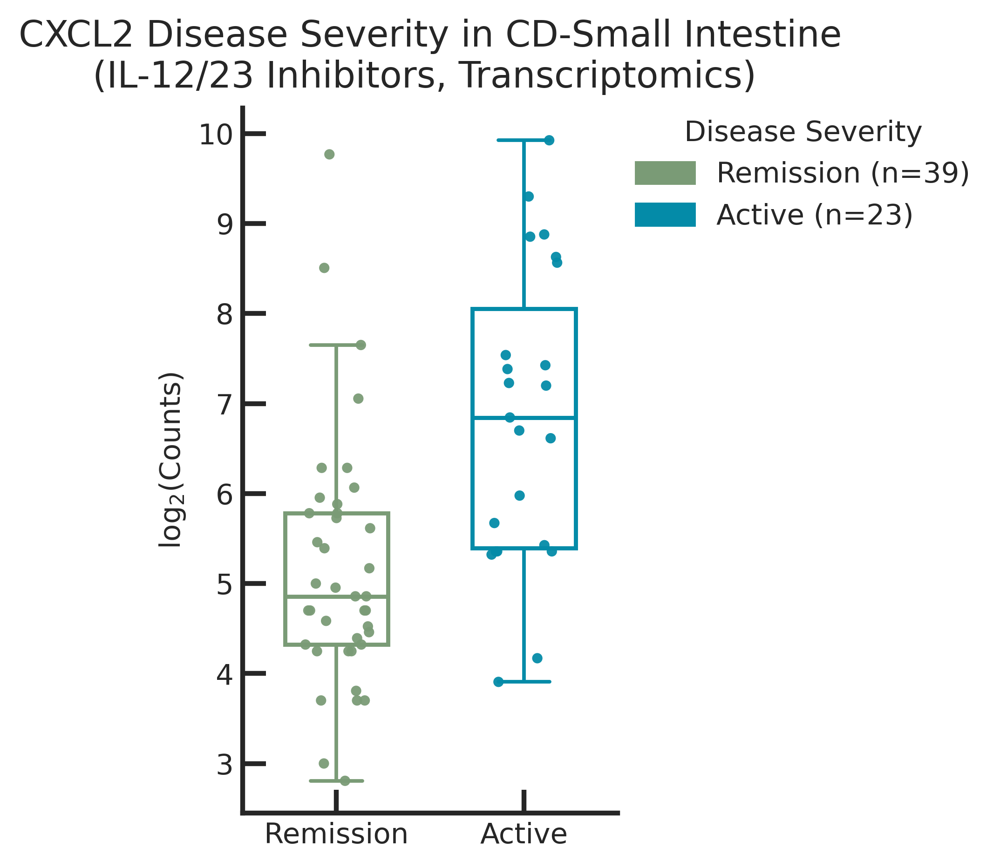

...

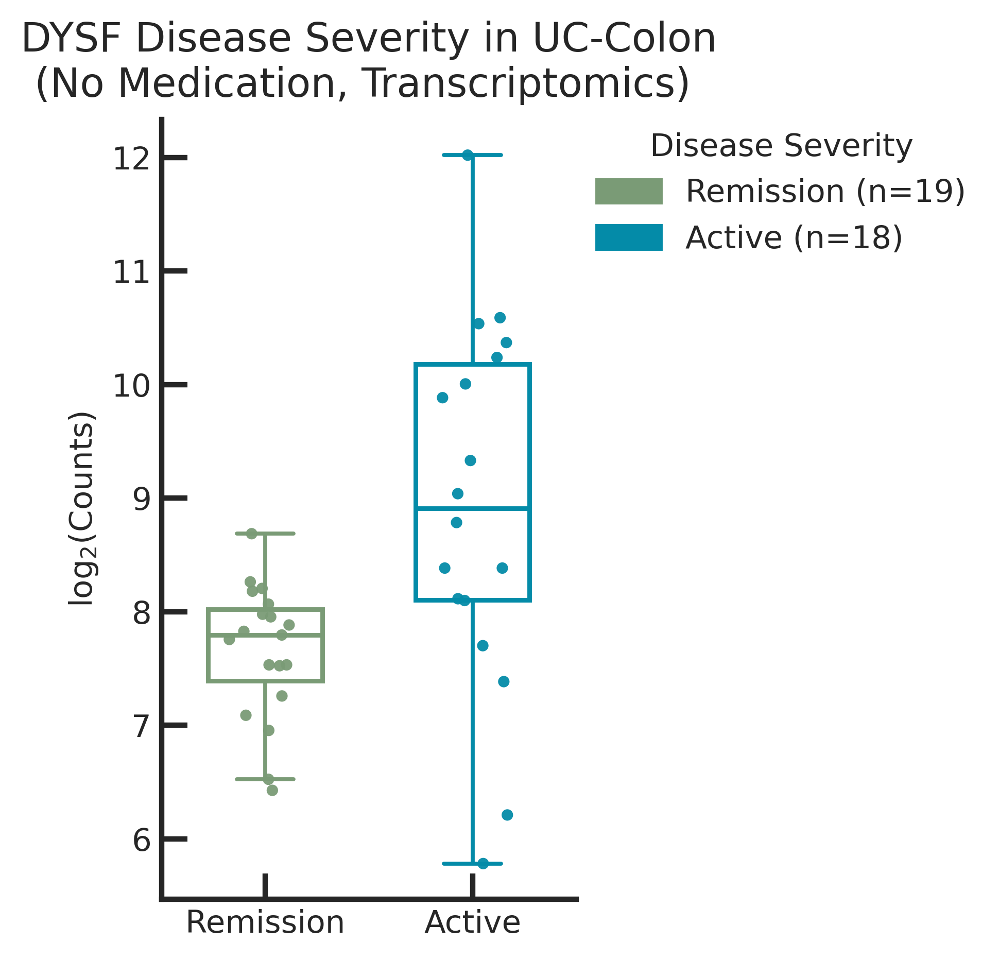

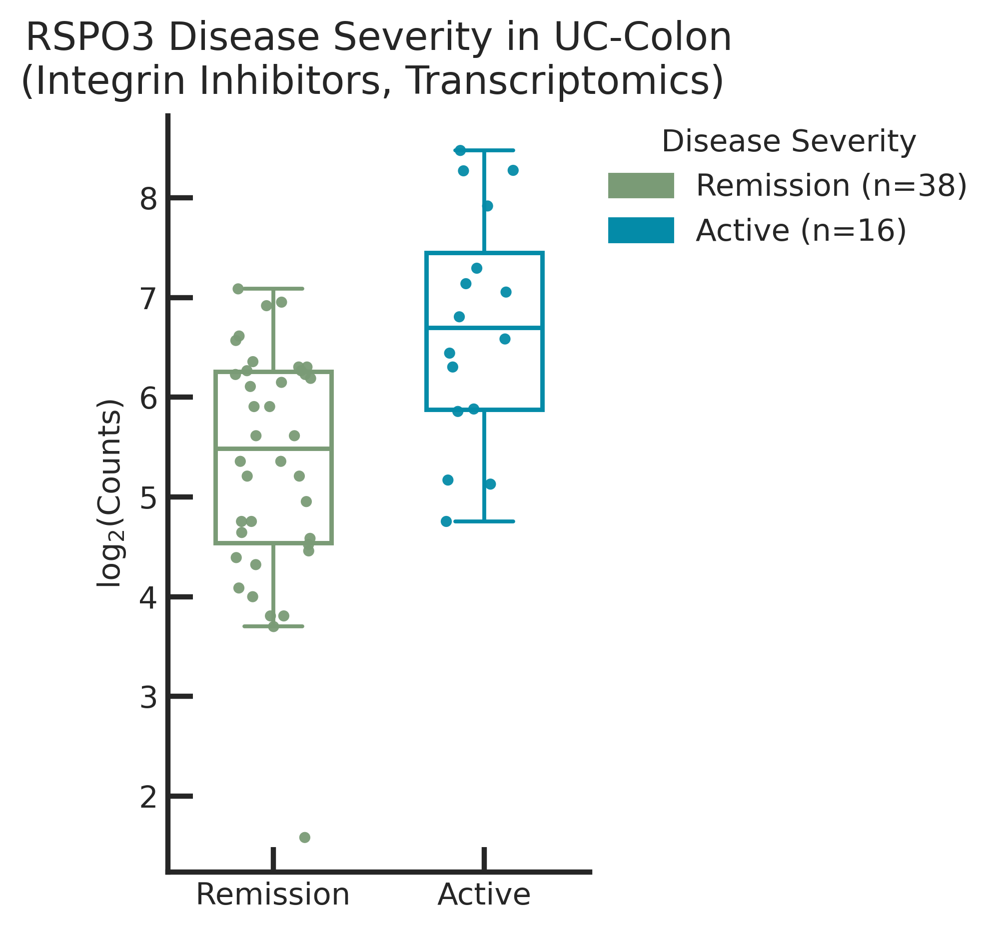

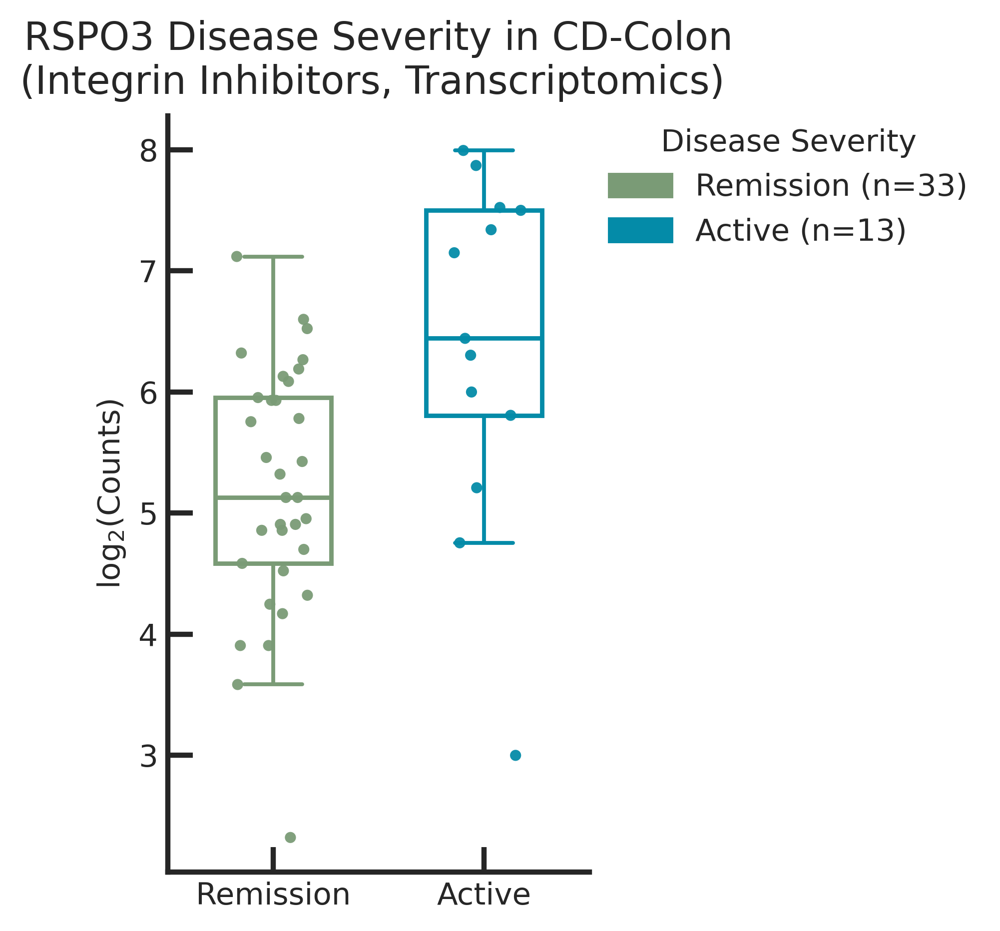

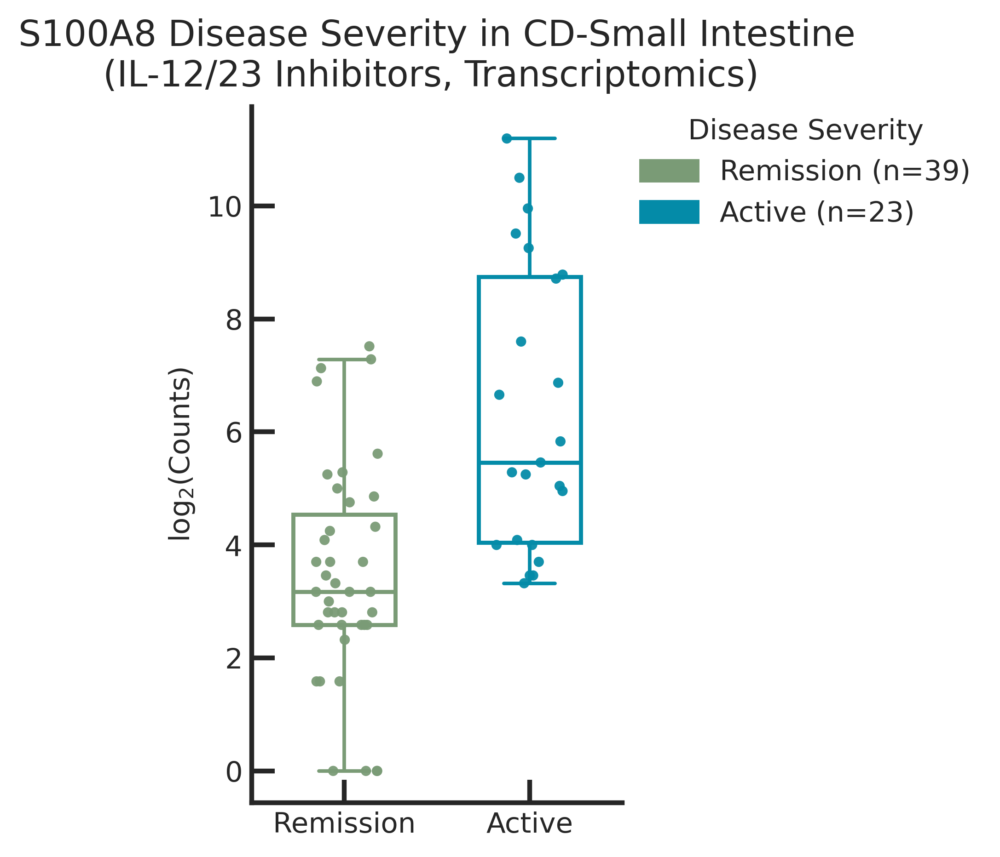

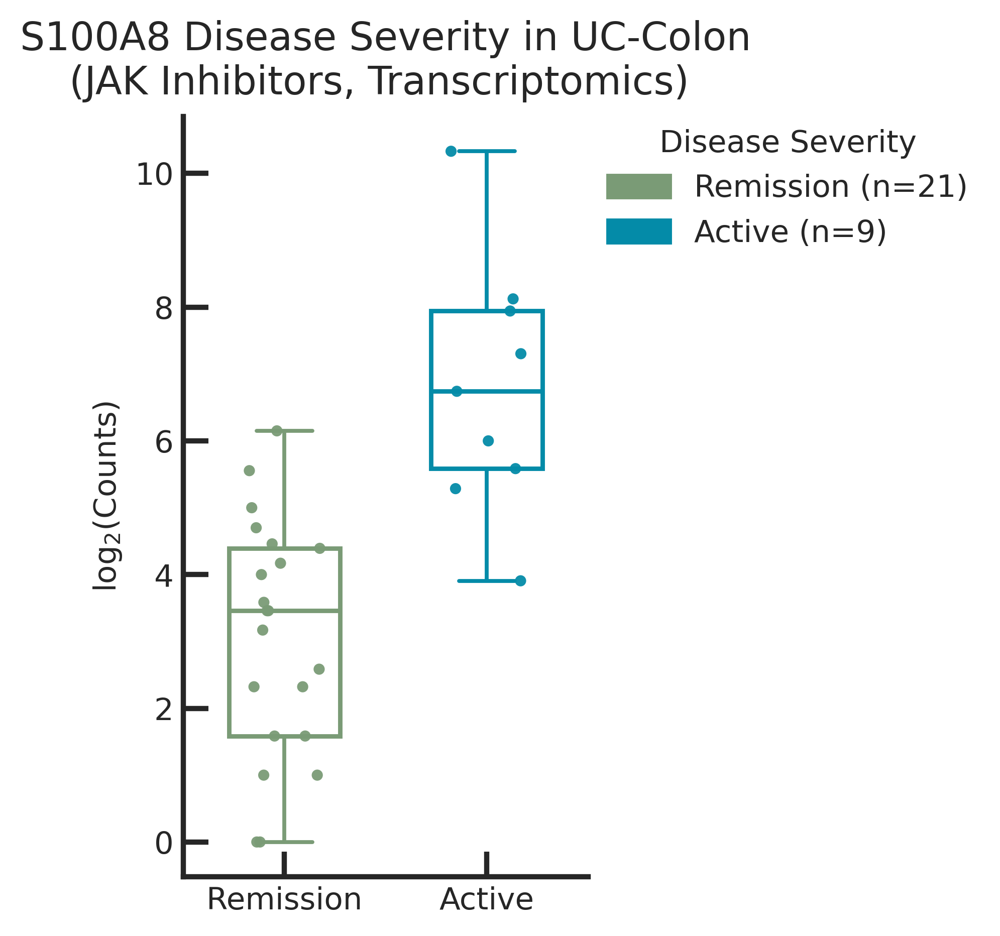

In [6]:
# loop through the significant genes
for index, row in plotting_tx_subset[['diagnosis', 'simple_tissue', 'drug_family', 'feature']].iterrows():
    gene = row['feature']
    diagnosis = row['diagnosis']
    simple_tissue = row['simple_tissue']
    drug_family = row['drug_family']

    # resolve gene column name in samples (handle '-' vs '_')
    candidate_cols = [gene, gene.replace('_', '-'), gene.replace('-', '_')]
    y_col = next((c for c in candidate_cols if c in tx_samples_subset.columns), None)
    if y_col is None:
        print(f"Skipping {gene}: column not found in transcriptomics samples")
        continue

    # subset samples to matching diagnosis and tissue for this gene context
    df_plot = tx_samples_subset[
        (tx_samples_subset['diagnosis'] == diagnosis) &
        (tx_samples_subset['simple_tissue'] == simple_tissue) &
        (tx_samples_subset['drug_family'] == drug_family)
    ]
    
    df_plot['disease_severity'] = df_plot['disease_severity'].astype(int)

    fig, ax = plot_strip_box_plot(
            df=df_plot,
            x="disease_severity",
            y=y_col,
            x_mode="severity",
            all_categories=[0, 1],
            palette_by_category=disease_severity_palette,
            title=f"{gene} Disease Severity in {diagnosis.upper()}-{simple_tissue.replace('_',' ').title()}\n({PLOTTING_DRUG_FAMILIES_MAP[drug_family]}, Transcriptomics) ",
            y_label=r'$\mathrm{log}_2(\mathrm{Counts})$',
            figsize=(5, 5),
            legend_facecolor=True,
            title_fontsize=14,
            xlabel_fontsize=11,
            ylabel_fontsize=11,
            legend_title_fontsize=11,
            legend_fontsize=11,
            dpi=400,
            alpha=0.95
        )


#### Proteomics

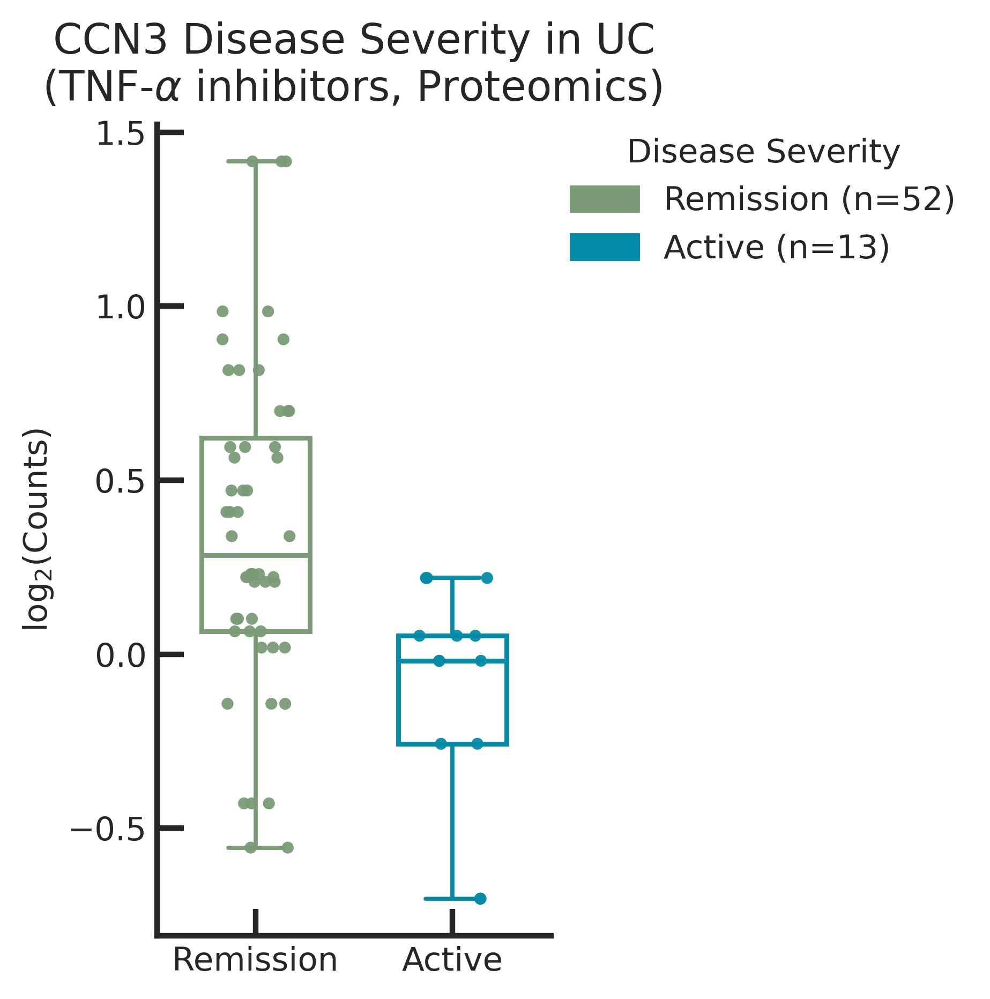

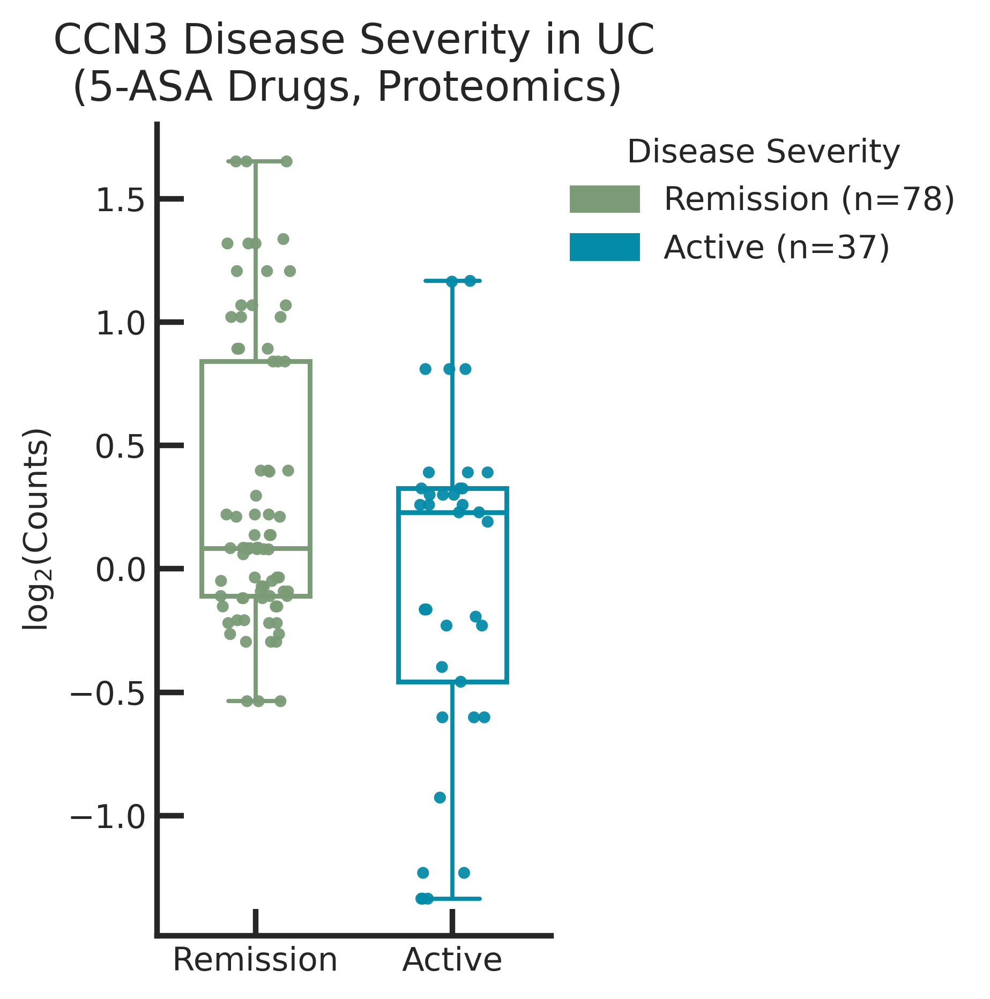

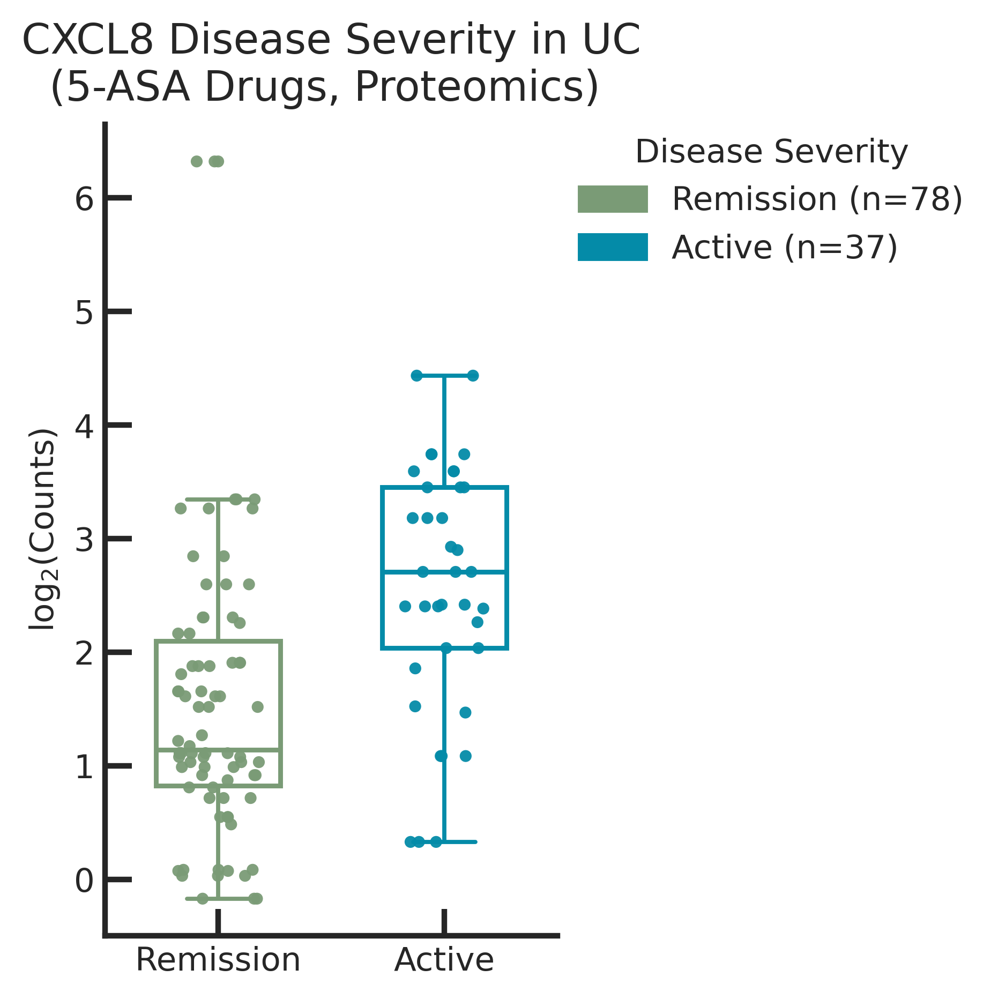

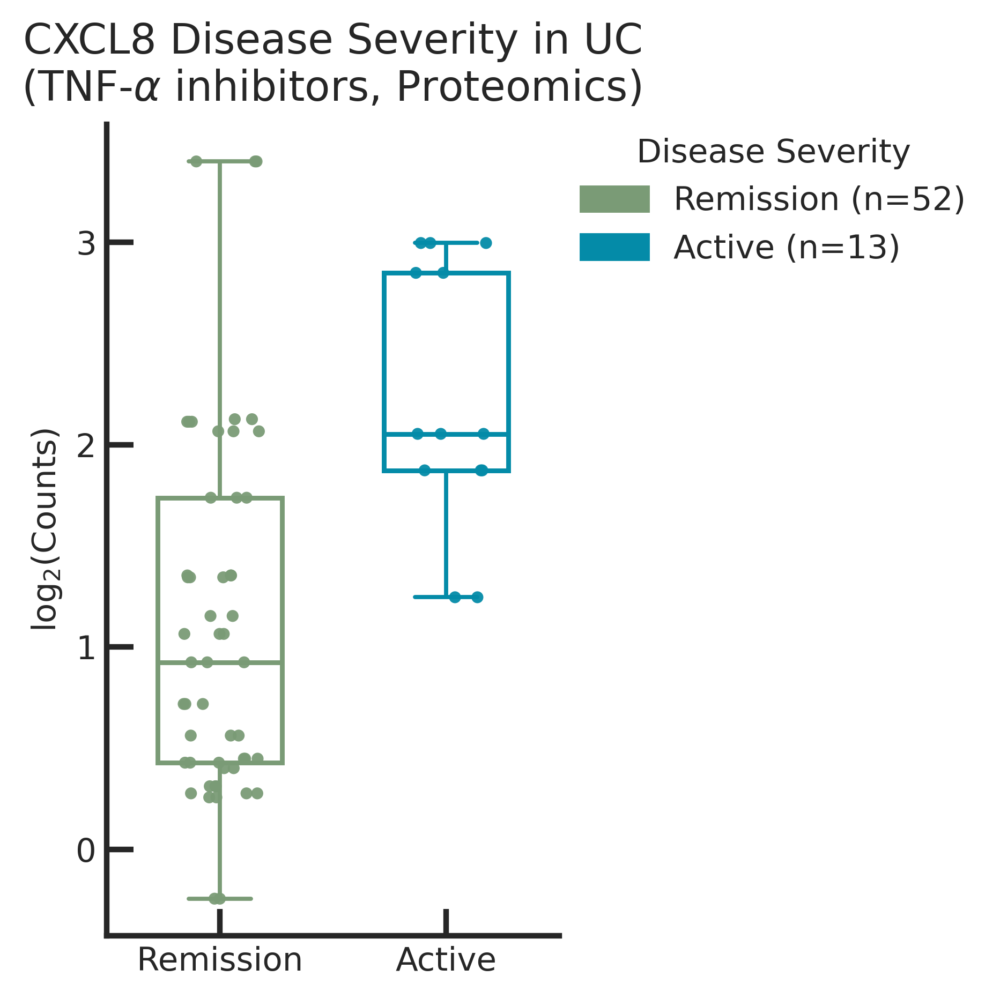

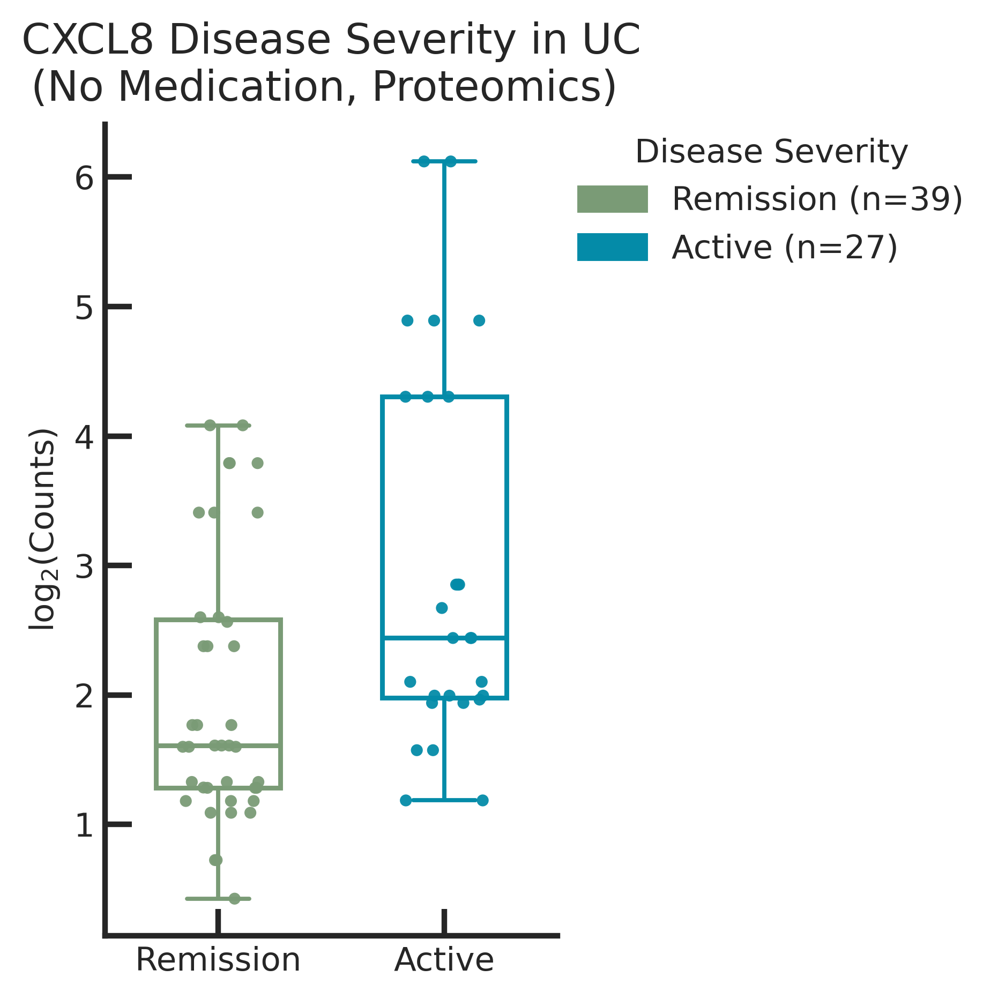

...

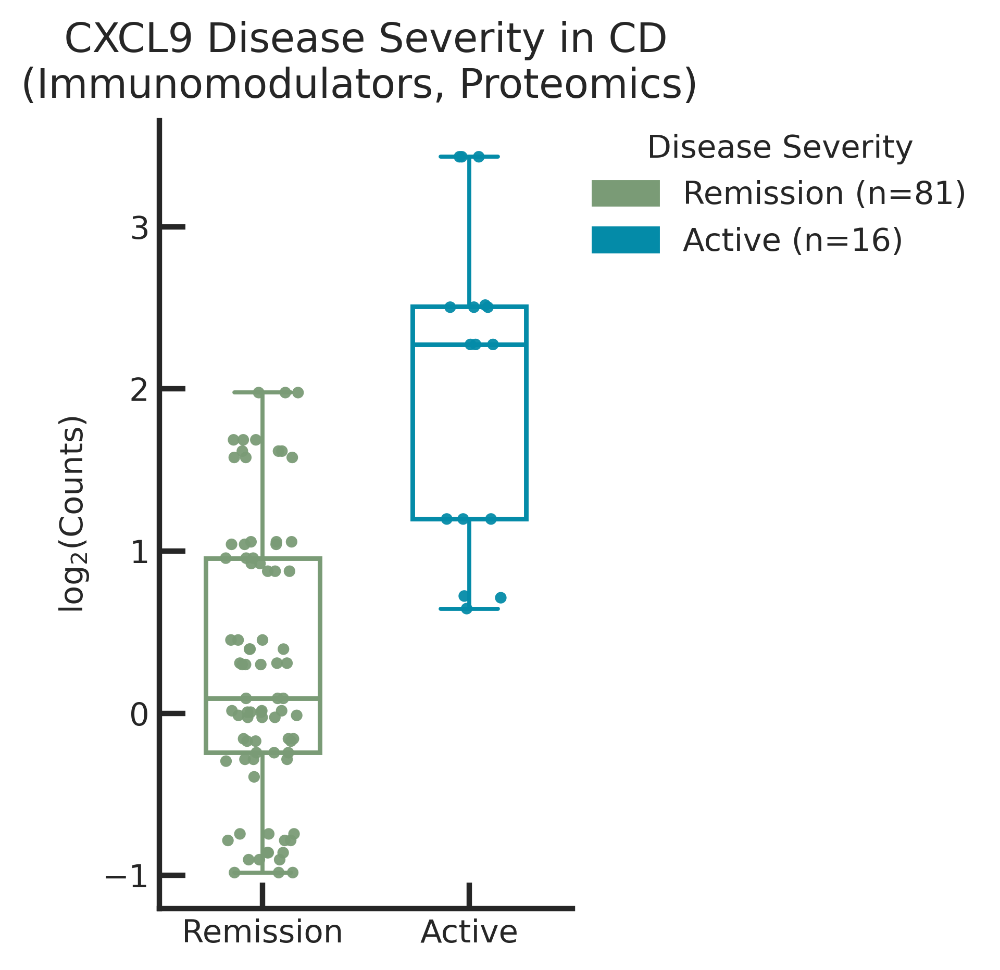

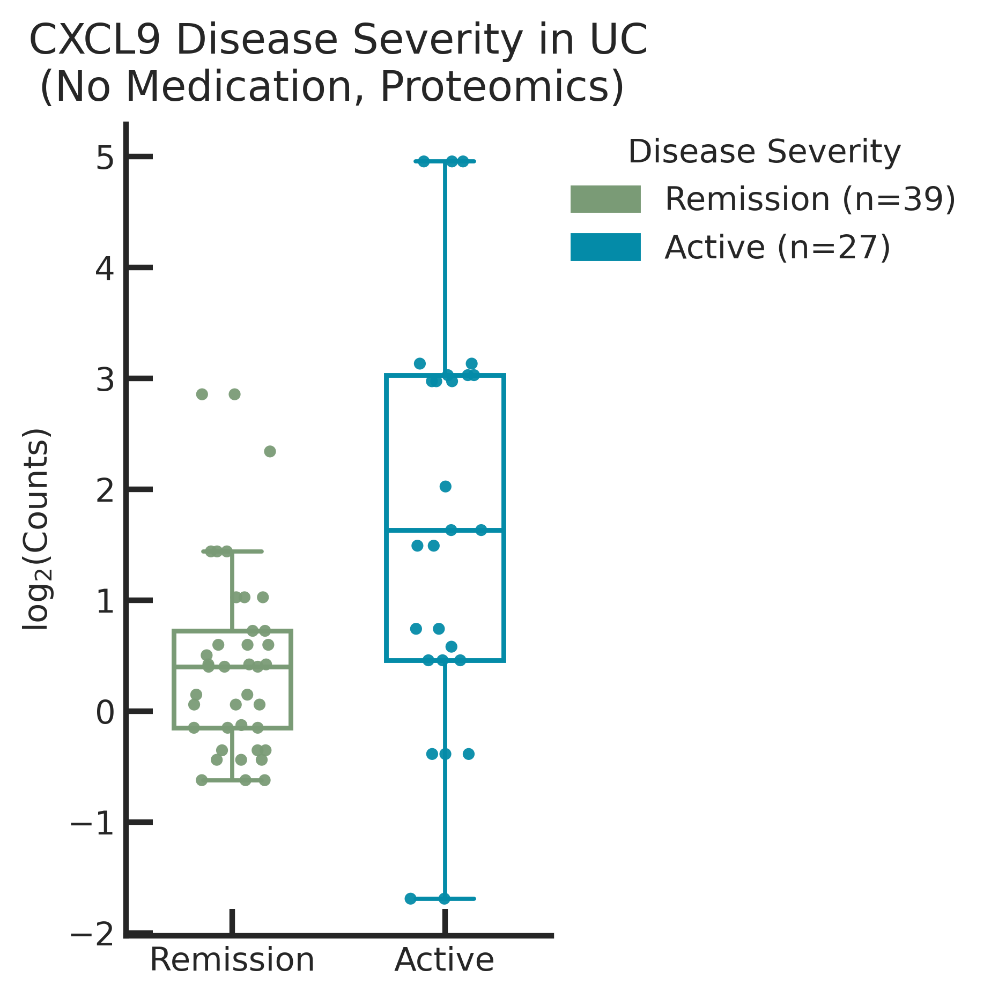

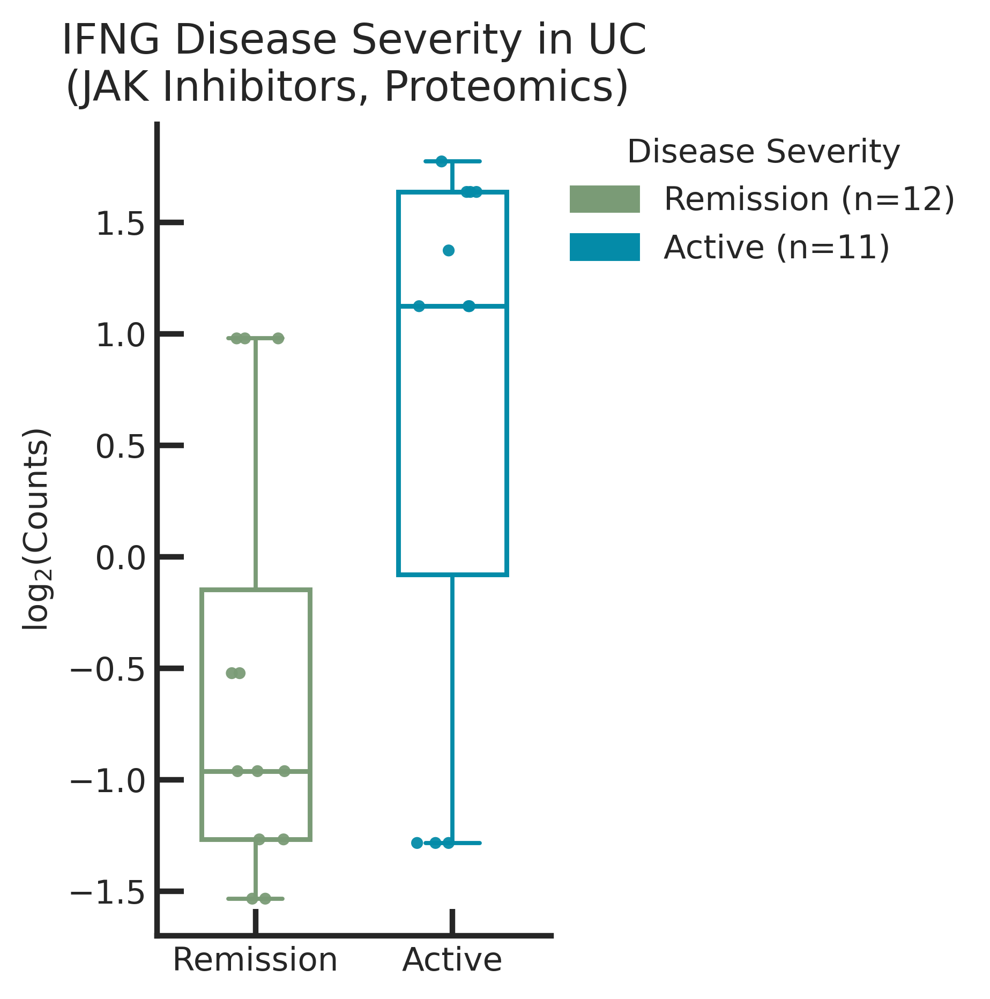

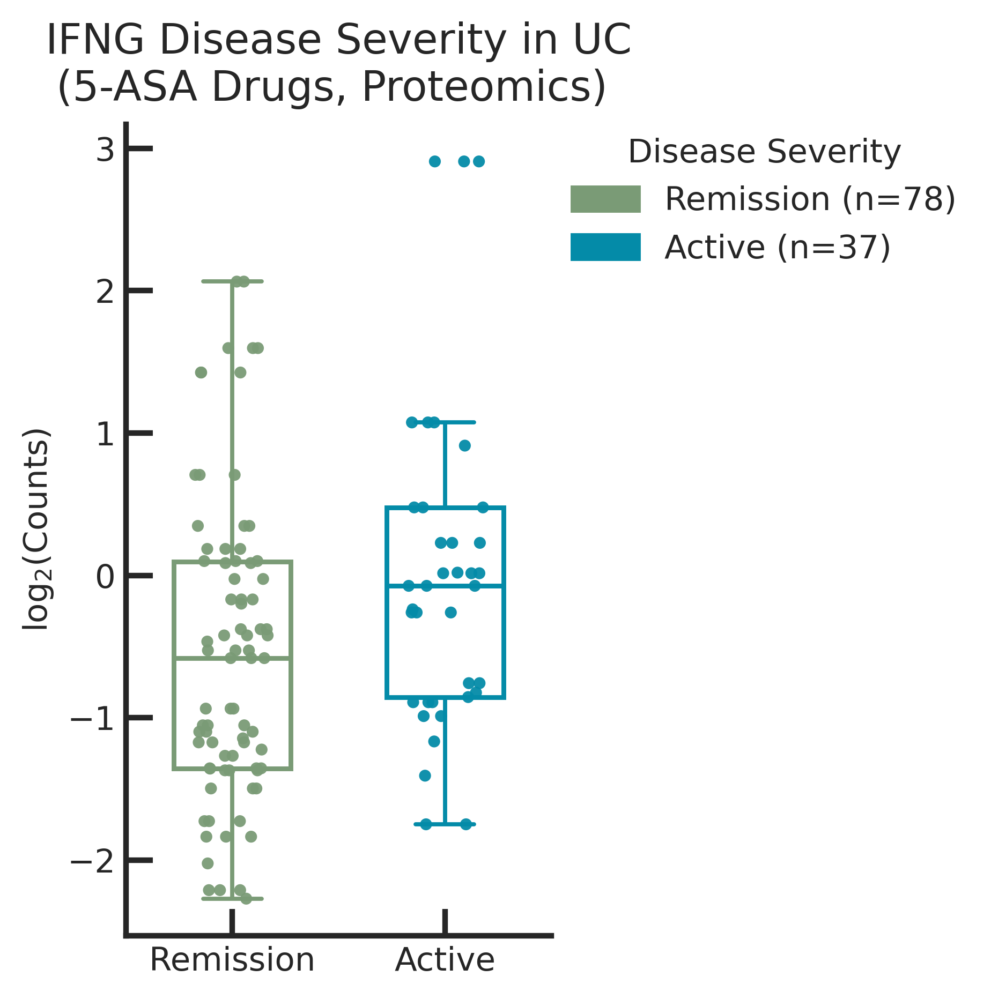

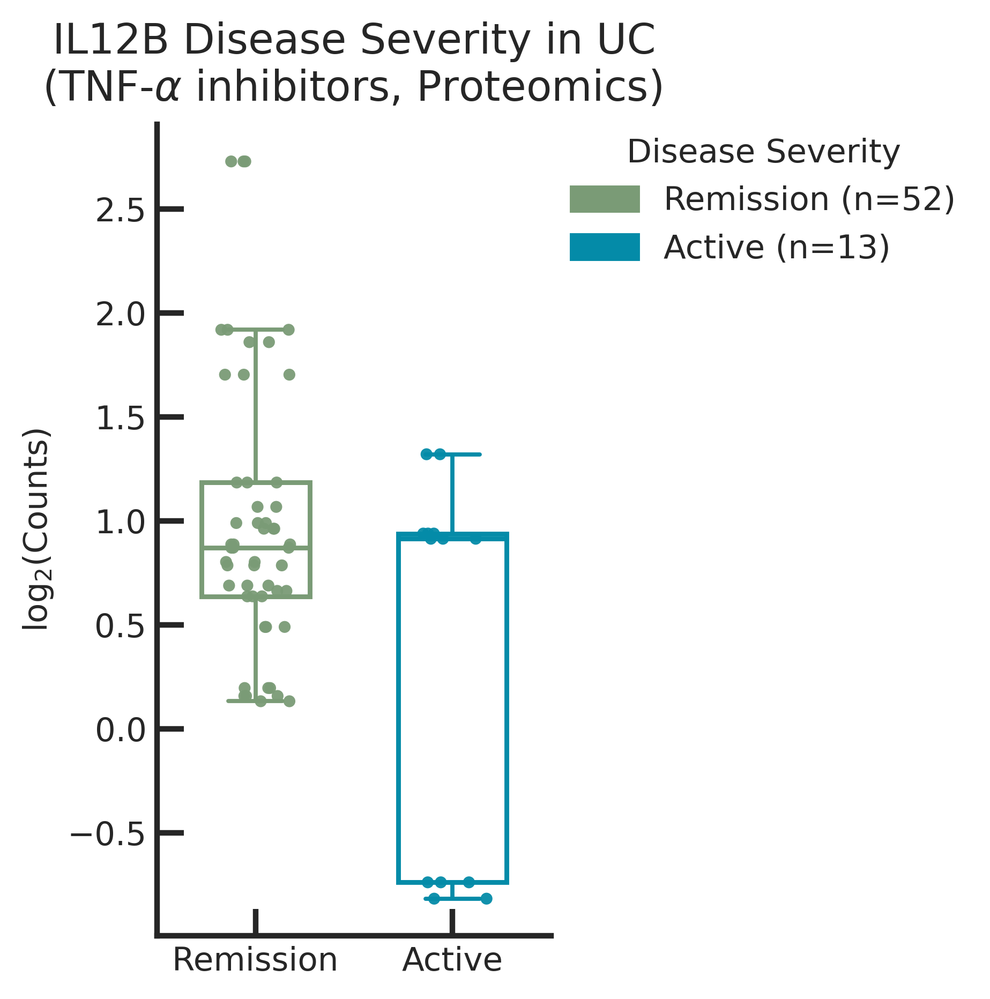

In [7]:
# loop through the significant genes
for index, row in plotting_px_subset[['diagnosis', 'drug_family', 'feature']].iterrows():
    gene = row['feature']
    diagnosis = row['diagnosis']
    drug_family = row['drug_family']

    # resolve gene column name in samples (handle '-' vs '_')
    candidate_cols = [gene, gene.replace('_', '-'), gene.replace('-', '_')]
    y_col = next((c for c in candidate_cols if c in px_samples_subset.columns), None)
    if y_col is None:
        print(f"Skipping {gene}: column not found in transcriptomics samples")
        continue

    # subset samples to matching diagnosis and tissue for this gene context
    df_plot = px_samples_subset[
        (px_samples_subset['diagnosis'] == diagnosis) &
        (px_samples_subset['drug_family'] == drug_family)
    ]
    
    df_plot['disease_severity'] = df_plot['disease_severity'].astype(int)

    fig, ax = plot_strip_box_plot(
            df=df_plot,
            x="disease_severity",
            y=y_col,
            x_mode="severity",
            all_categories=[0, 1],
            palette_by_category=disease_severity_palette,
            title=f"{gene.split('_')[0]} Disease Severity in {diagnosis.upper()}\n({PLOTTING_DRUG_FAMILIES_MAP[drug_family]}, Proteomics) ",
            y_label=r'$\mathrm{log}_2(\mathrm{Counts})$',
            figsize=(5, 5),
            legend_facecolor=True,
            title_fontsize=14,
            xlabel_fontsize=11,
            ylabel_fontsize=11,
            legend_title_fontsize=11,
            legend_fontsize=11,
            dpi=400,
            alpha=0.95
        )


# Rem vs. Active for Response Genes (for figure 5)

7 7


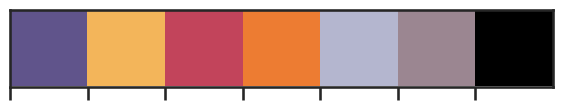

In [8]:
raw_drugs_families = sorted(list(set(tx_rem_vs_act.drug_family.unique().tolist() + px_rem_vs_act.drug_family.unique().tolist()) ))
raw_drugs_families.remove(NO_MEDICATION)

# getting the unique drug families and making 'No Medication' the last item

all_unique_drug_families = raw_drugs_families + [NO_MEDICATION]

# building the palette
drug_family_palette = build_fixed_palette(all_unique_drug_families, palette=MUTED_MODERN_ALL_DRUGS)

# show the palette
sns.palplot(drug_family_palette.values())

In [9]:
all_unique_drug_families

['Aminosalicylates (5-ASA drugs)',
 'IL-12/23 inhibitor',
 'Immunomodulating antimetabolites',
 'Integrin-receptor antagonists',
 'JAK inhibitors',
 'TNF-alpha inhibitors',
 'No Medication']

#### Transcriptomics

/home/timothy.hart/ccf-medication/ccf_medication/plotting/stripplots.py:141: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=figsize, dpi=dpi)


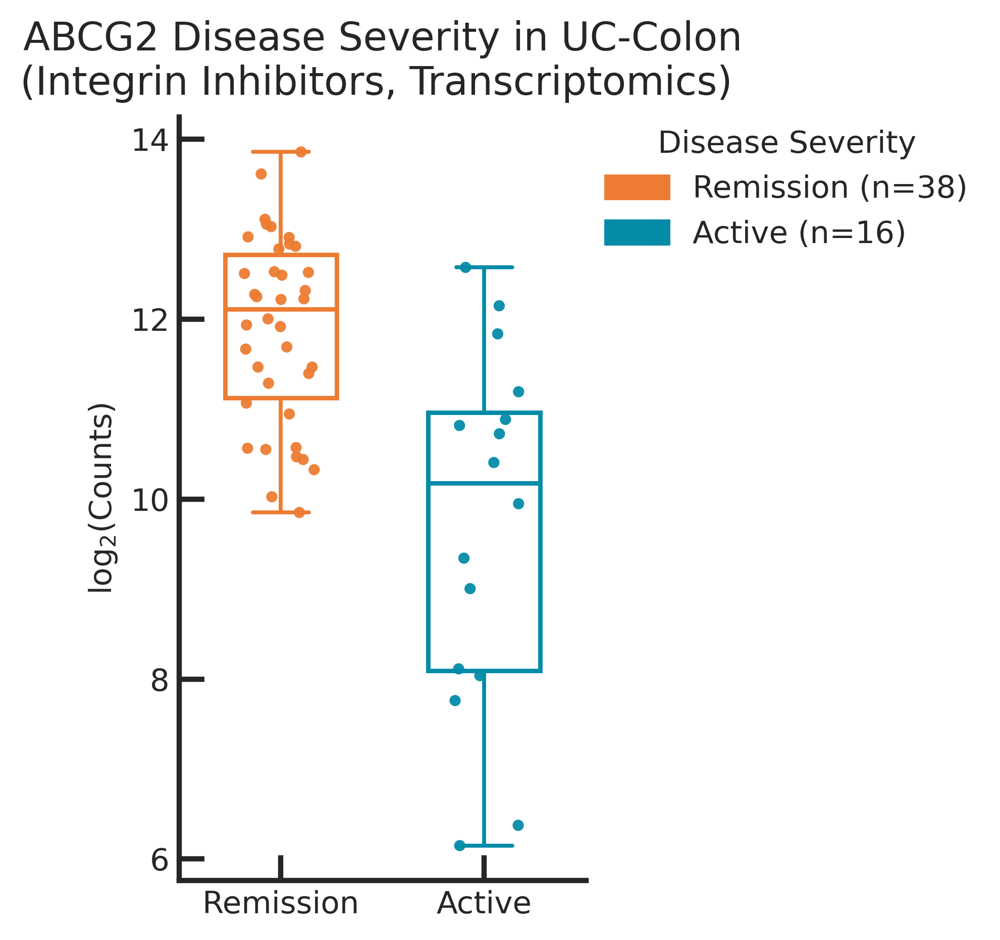

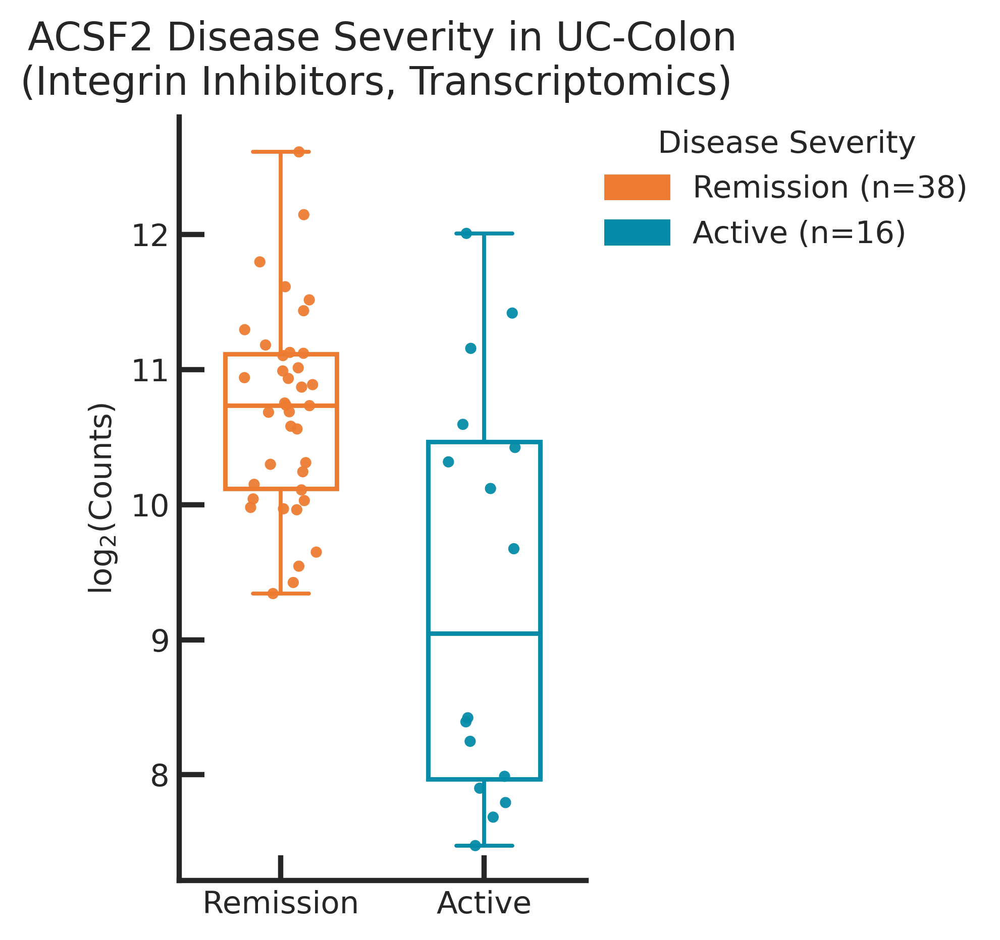

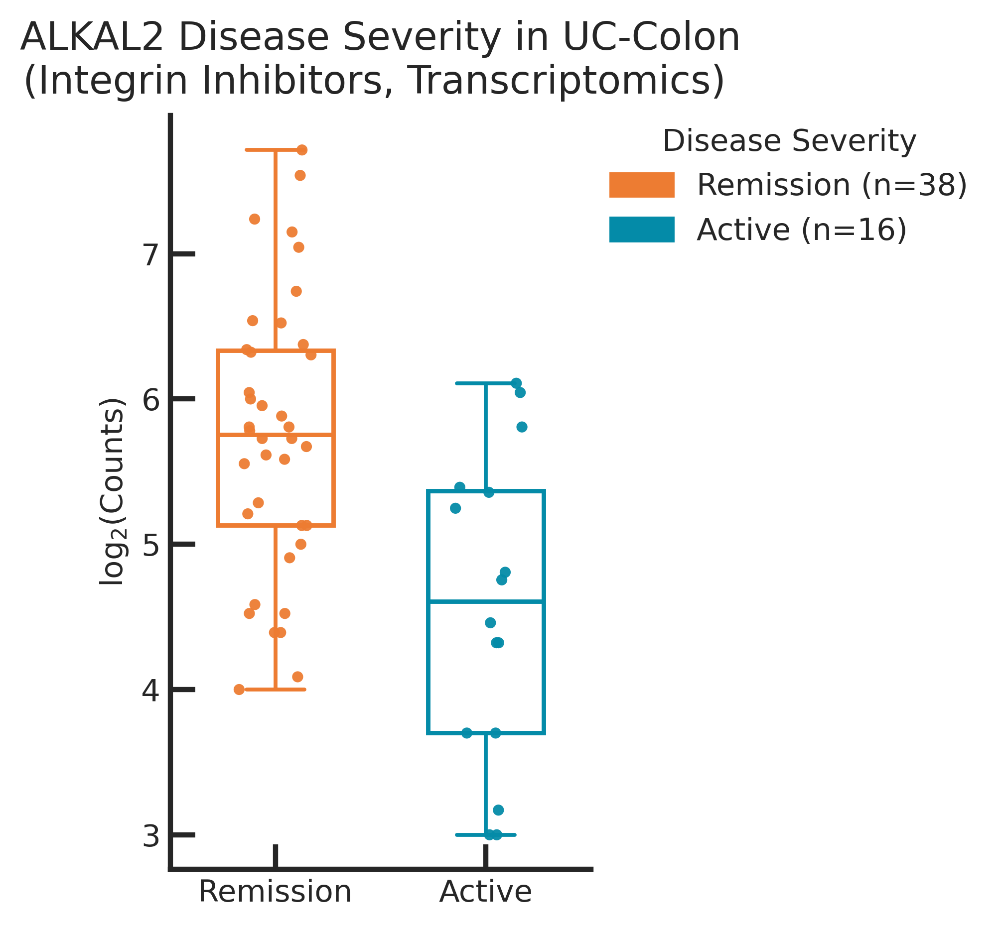

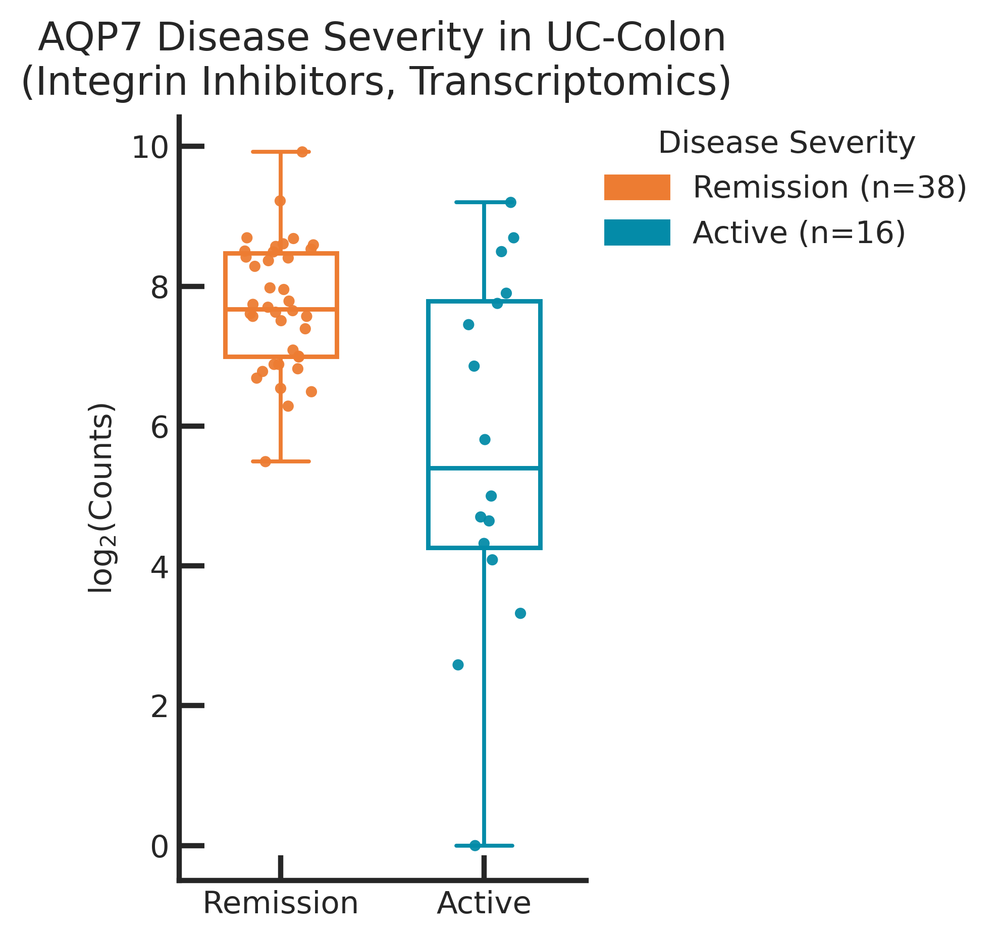

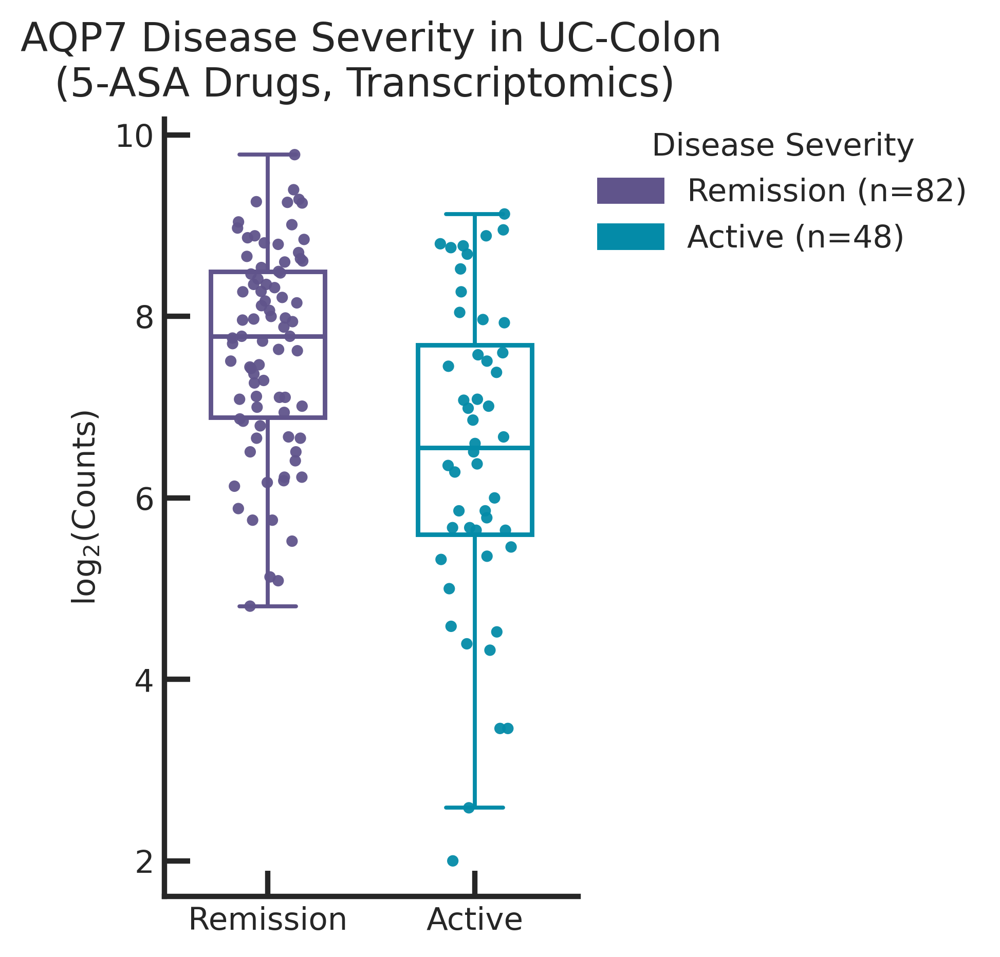

...

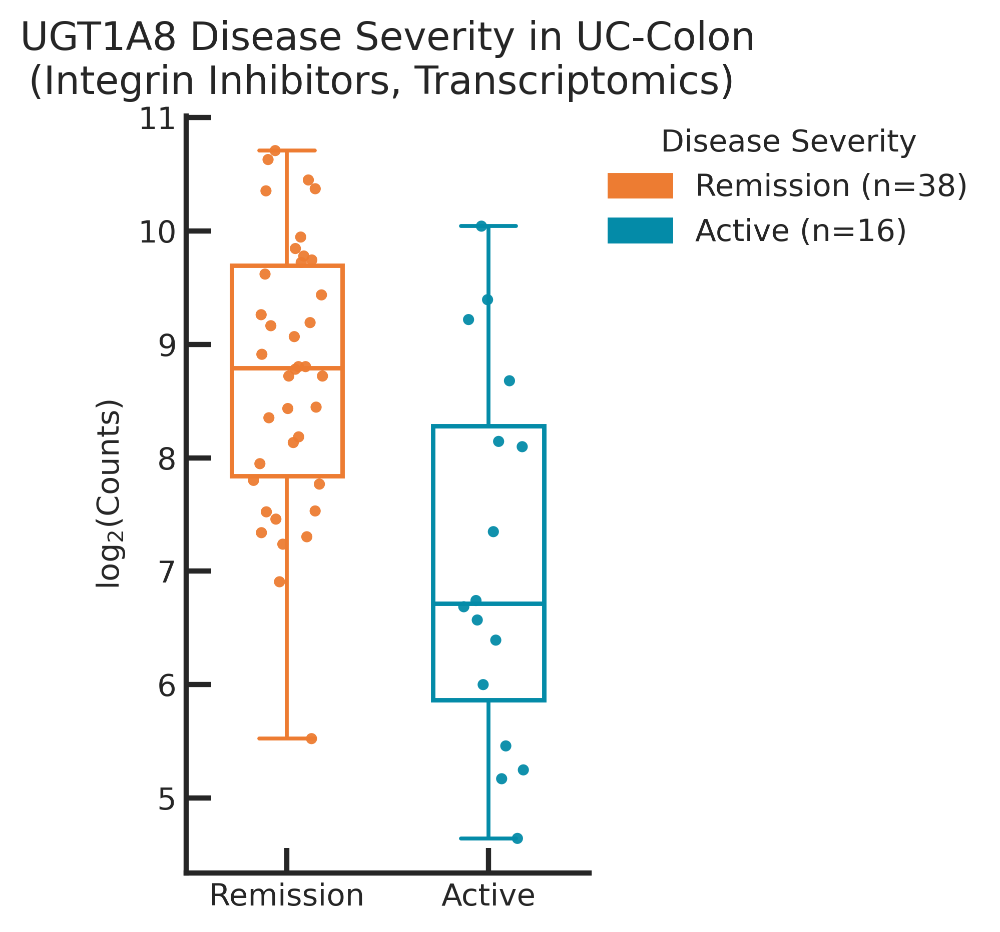

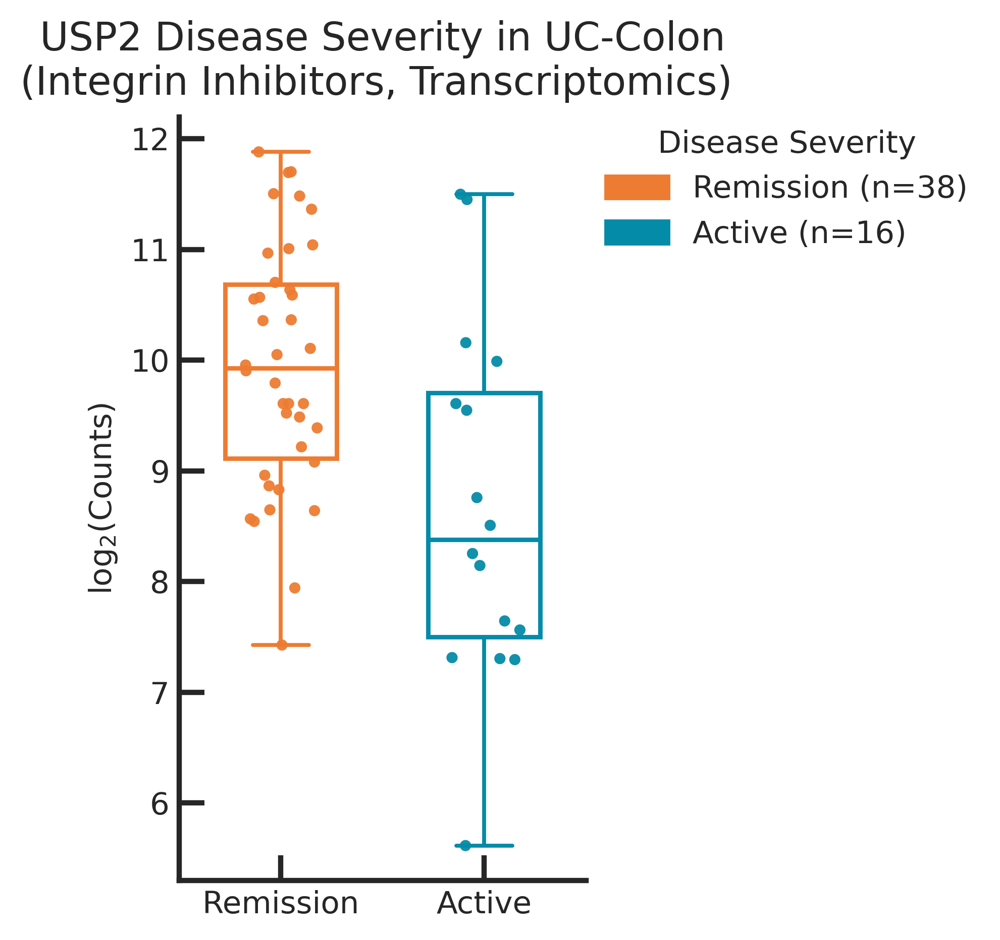

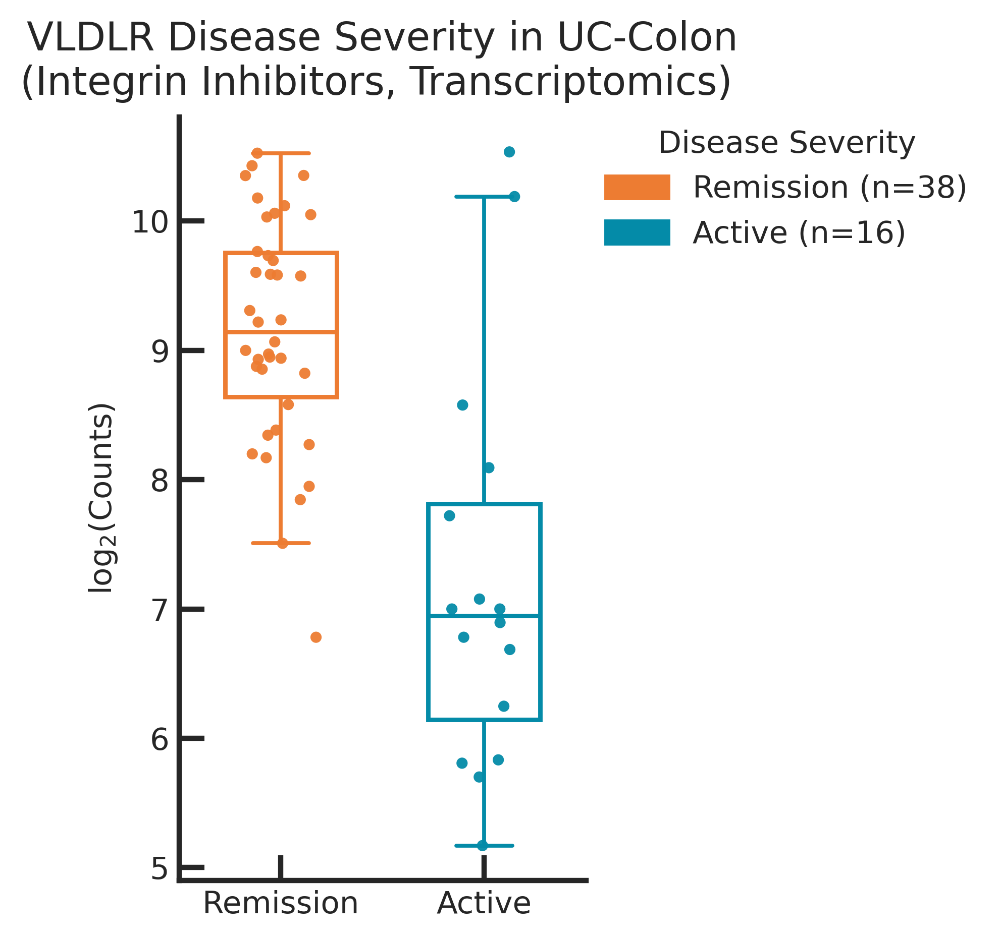

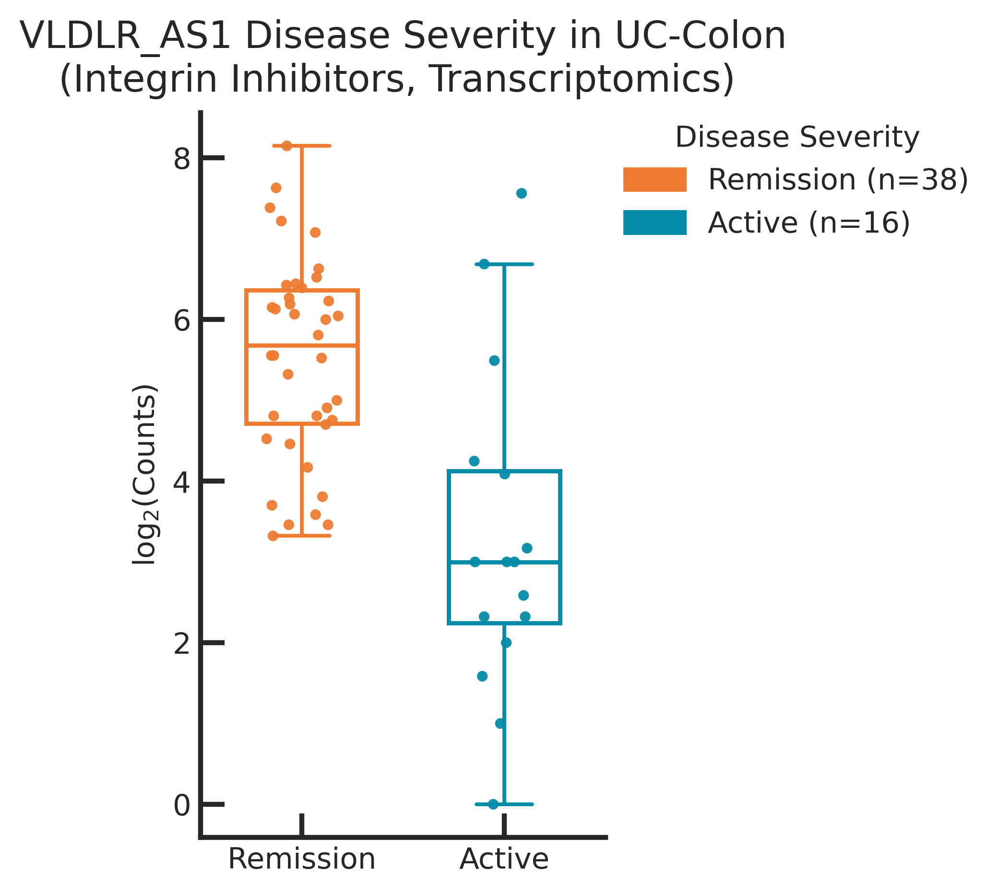

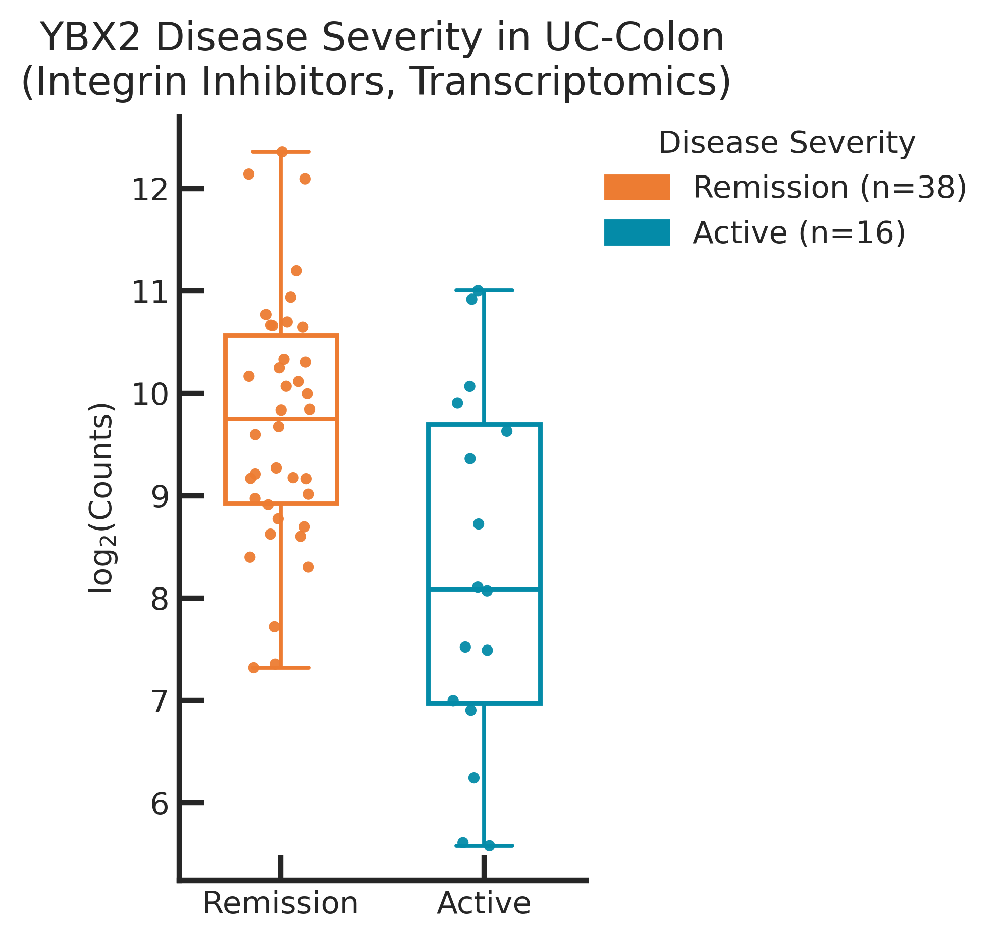

In [10]:
# loop through the significant genes
tx_response = tx_response.sort_values(by='feature')
for index, row in tx_response[['diagnosis', 'simple_tissue', 'drug_family', 'feature']].iterrows():
    gene = row['feature']
    diagnosis = row['diagnosis']
    simple_tissue = row['simple_tissue']
    drug_family = row['drug_family']

    # resolve gene column name in samples (handle '-' vs '_')
    candidate_cols = [gene, gene.replace('_', '-'), gene.replace('-', '_')]
    y_col = next((c for c in candidate_cols if c in tx_samples_subset.columns), None)
    if y_col is None:
        print(f"Skipping {gene}: column not found in transcriptomics samples")
        continue

    # subset samples to matching diagnosis and tissue for this gene context
    df_plot = tx_samples_subset[
        (tx_samples_subset['diagnosis'] == diagnosis) &
        (tx_samples_subset['simple_tissue'] == simple_tissue) &
        (tx_samples_subset['drug_family'] == drug_family)
    ]
    
    df_plot['disease_severity'] = df_plot['disease_severity'].astype(int)

    temp_palette = disease_severity_palette.copy()
    temp_palette[0] = drug_family_palette[drug_family]

    fig, ax = plot_strip_box_plot(
            df=df_plot,
            x="disease_severity",
            y=y_col,
            x_mode="severity",
            all_categories=[0, 1],
            palette_by_category=temp_palette,
            title=f"{gene} Disease Severity in {diagnosis.upper()}-{simple_tissue.replace('_',' ').title()}\n({PLOTTING_DRUG_FAMILIES_MAP[drug_family]}, Transcriptomics) ",
            y_label=r'$\mathrm{log}_2(\mathrm{Counts})$',
            figsize=(5, 5),
            legend_facecolor=True,
            title_fontsize=14,
            xlabel_fontsize=11,
            ylabel_fontsize=11,
            legend_title_fontsize=11,
            legend_fontsize=11,
            dpi=400,
            alpha=0.95
        )


#### Proteomics

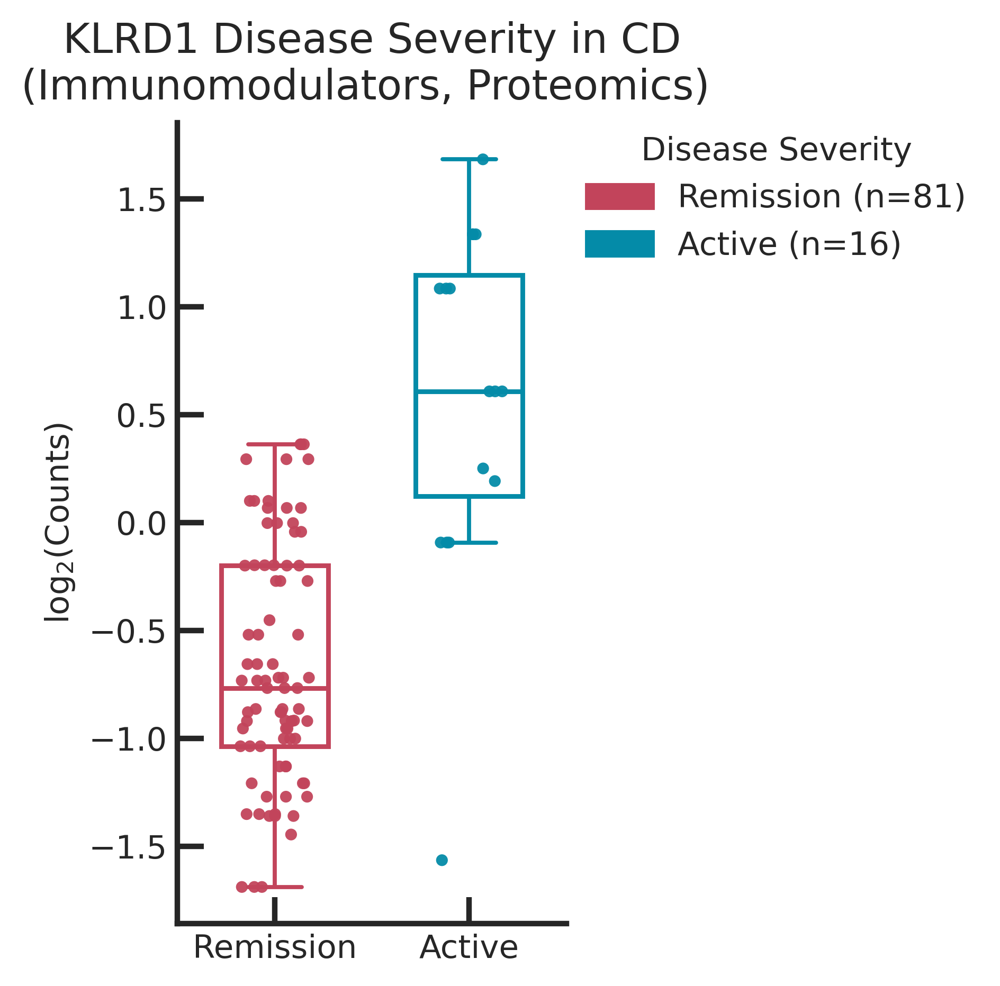

In [11]:
# loop through the significant genes
px_response = px_response.sort_values(by='feature')
for index, row in px_response[['diagnosis', 'drug_family', 'feature']].iterrows():
    gene = row['feature']
    diagnosis = row['diagnosis']
    drug_family = row['drug_family']

    # resolve gene column name in samples (handle '-' vs '_')
    candidate_cols = [gene, gene.replace('_', '-'), gene.replace('-', '_')]
    y_col = next((c for c in candidate_cols if c in px_samples_subset.columns), None)
    if y_col is None:
        print(f"Skipping {gene}: column not found in transcriptomics samples")
        continue

    # subset samples to matching diagnosis and tissue for this gene context
    df_plot = px_samples_subset[
        (px_samples_subset['diagnosis'] == diagnosis) &
        (px_samples_subset['drug_family'] == drug_family)
    ]
    
    df_plot['disease_severity'] = df_plot['disease_severity'].astype(int)

    temp_palette = disease_severity_palette.copy()
    temp_palette[0] = drug_family_palette[drug_family]

    fig, ax = plot_strip_box_plot(
            df=df_plot,
            x="disease_severity",
            y=y_col,
            x_mode="severity",
            all_categories=[0, 1],
            palette_by_category=temp_palette,
            title=f"{gene.split('_')[0]} Disease Severity in {diagnosis.upper()}\n({PLOTTING_DRUG_FAMILIES_MAP[drug_family]}, Proteomics) ",
            y_label=r'$\mathrm{log}_2(\mathrm{Counts})$',
            figsize=(5, 5),
            legend_facecolor=True,
            title_fontsize=14,
            xlabel_fontsize=11,
            ylabel_fontsize=11,
            legend_title_fontsize=11,
            legend_fontsize=11,
            dpi=400,
            alpha=0.95
        )
